# **Stable Diffusion** 🎨
*...using `🧨diffusers`*

Stable Diffusion is a text-to-image latent diffusion model created by the researchers and engineers from [CompVis](https://github.com/CompVis), [Stability AI](https://stability.ai/) and [LAION](https://laion.ai/). It's trained on 512x512 images from a subset of the [LAION-5B](https://laion.ai/blog/laion-5b/) database. This model uses a frozen CLIP ViT-L/14 text encoder to condition the model on text prompts. With its 860M UNet and 123M text encoder, the model is relatively lightweight and can run on many consumer GPUs.
See the [model card](https://huggingface.co/CompVis/stable-diffusion) for more information.

This Colab notebook shows how to use Stable Diffusion with the 🤗 Hugging Face [🧨 Diffusers library](https://github.com/huggingface/diffusers). 

Let's get started!

## 1. How to use `StableDiffusionPipeline`

Before diving into the theoretical aspects of how Stable Diffusion functions, 
let's try it out a bit 🤗.

In this section, we show how you can run text to image inference in just a few lines of code!

### Setup

First, please make sure you are using a GPU runtime to run this notebook, so inference is much faster. If the following command fails, use the `Runtime` menu above and select `Change runtime type`.

In [2]:
!nvidia-smi

Tue Nov 28 08:36:59 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 546.17                 Driver Version: 546.17       CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce GTX 1080 Ti   WDDM  | 00000000:01:00.0  On |                  N/A |
| 40%   26C    P0              58W / 250W |   1688MiB / 11264MiB |      2%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

Next, you should install `diffusers` as well `scipy`, `ftfy` and `transformers`. `accelerate` is used to achieve much faster loading.

In [1]:
from IPython.display import clear_output

!pip install diffusers
!pip install transformers scipy ftfy accelerate omegaconf

clear_output()

### Stable Diffusion Pipeline

`StableDiffusionPipeline` is an end-to-end inference pipeline that you can use to generate images from text with just a few lines of code.

First, we load the pre-trained weights of all components of the model. In this notebook we use Stable Diffusion version 1.4 ([CompVis/stable-diffusion-v1-4](https://huggingface.co/CompVis/stable-diffusion-v1-4)), but there are other variants that you may want to try:
* [runwayml/stable-diffusion-v1-5](https://huggingface.co/runwayml/stable-diffusion-v1-5)
* [stabilityai/stable-diffusion-2-1-base](https://huggingface.co/stabilityai/stable-diffusion-2-1-base)
* [stabilityai/stable-diffusion-2-1](https://huggingface.co/stabilityai/stable-diffusion-2-1). This version can produce images with a resolution of 768x768, while the others work at 512x512.

In addition to the model id [CompVis/stable-diffusion-v1-4](https://huggingface.co/CompVis/stable-diffusion-v1-4), we're also passing a specific `revision` and `torch_dtype` to the `from_pretrained` method.

We want to ensure that every free Google Colab can run Stable Diffusion, hence we're loading the weights from the half-precision branch [`fp16`](https://huggingface.co/CompVis/stable-diffusion-v1-4/tree/fp16) and also tell `diffusers` to expect the weights in float16 precision by passing `torch_dtype=torch.float16`.

If you want to ensure the highest possible precision, please make sure to remove `torch_dtype=torch.float16` at the cost of a higher memory usage.

In [1]:
import torch
from diffusers import (
    StableDiffusionPipeline,
    StableDiffusionXLPipeline,
    DPMSolverMultistepScheduler,
)
from PIL import Image

A matching Triton is not available, some optimizations will not be enabled.
Error caught was: No module named 'triton'


In [2]:
# version = "runwayml/stable-diffusion-v1-5"
# version = "stabilityai/stable-diffusion-2-1"
# pipe = StableDiffusionPipeline.from_pretrained(version, dtype=torch.float16)
# pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)
# pipe

In [6]:
# model_path = "D:/ml/code/gen/stable-diffusion-v1-5/v1-5-pruned-emaonly.safetensors"
model_path = "D:/ml/code/gen/stable-diffusion-2-1/v2-1_768-ema-pruned.safetensors"
pipe = StableDiffusionPipeline.from_single_file(model_path, dtype=torch.float16)
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)
pipe

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .
d:\miniconda3\envs\pytorch\Lib\site-packages\diffusers\configuration_utils.py:134: FutureWarning: Accessing config attribute `requires_safety_checker` directly via 'StableDiffusionPipeline' object attribute is deprecated. Please access 'requires_safety_checker' over 'StableDiffusionPipeline's config object instead, e.g. 'scheduler.config.requires

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.23.1",
  "feature_extractor": [
    null,
    null
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "DPMSolverMultistepScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

Next, let's move the pipeline to GPU to have faster inference.

In [7]:
pipe = pipe.to("cuda")

And we are ready to generate images:

In [9]:
pipe.config

FrozenDict([('vae', ('diffusers', 'AutoencoderKL')),
            ('text_encoder', ('transformers', 'CLIPTextModel')),
            ('tokenizer', ('transformers', 'CLIPTokenizer')),
            ('unet', ('diffusers', 'UNet2DConditionModel')),
            ('scheduler', ('diffusers', 'DPMSolverMultistepScheduler')),
            ('safety_checker', (None, None)),
            ('feature_extractor', (None, None)),
            ('requires_safety_checker', True),
            ('_class_name', 'StableDiffusionPipeline'),
            ('_diffusers_version', '0.23.1')])

In [10]:
# pipe.__call__()
r"""
The call function to the pipeline for generation.

Args:
    prompt (`str` or `List[str]`, *optional*):
        The prompt or prompts to guide image generation. If not defined, you need to pass `prompt_embeds`.
    height (`int`, *optional*, defaults to `self.unet.config.sample_size * self.vae_scale_factor`):
        The height in pixels of the generated image.
    width (`int`, *optional*, defaults to `self.unet.config.sample_size * self.vae_scale_factor`):
        The width in pixels of the generated image.
    num_inference_steps (`int`, *optional*, defaults to 50):
        The number of denoising steps. More denoising steps usually lead to a higher quality image at the
        expense of slower inference.
    guidance_scale (`float`, *optional*, defaults to 7.5):
        A higher guidance scale value encourages the model to generate images closely linked to the text
        `prompt` at the expense of lower image quality. Guidance scale is enabled when `guidance_scale > 1`.
    negative_prompt (`str` or `List[str]`, *optional*):
        The prompt or prompts to guide what to not include in image generation. If not defined, you need to
        pass `negative_prompt_embeds` instead. Ignored when not using guidance (`guidance_scale < 1`).
    num_images_per_prompt (`int`, *optional*, defaults to 1):
        The number of images to generate per prompt.
    eta (`float`, *optional*, defaults to 0.0):
        Corresponds to parameter eta (η) from the [DDIM](https://arxiv.org/abs/2010.02502) paper. Only applies
        to the [`~schedulers.DDIMScheduler`], and is ignored in other schedulers.
    generator (`torch.Generator` or `List[torch.Generator]`, *optional*):
        A [`torch.Generator`](https://pytorch.org/docs/stable/generated/torch.Generator.html) to make
        generation deterministic.
    latents (`torch.FloatTensor`, *optional*):
        Pre-generated noisy latents sampled from a Gaussian distribution, to be used as inputs for image
        generation. Can be used to tweak the same generation with different prompts. If not provided, a latents
        tensor is generated by sampling using the supplied random `generator`.
    prompt_embeds (`torch.FloatTensor`, *optional*):
        Pre-generated text embeddings. Can be used to easily tweak text inputs (prompt weighting). If not
        provided, text embeddings are generated from the `prompt` input argument.
    negative_prompt_embeds (`torch.FloatTensor`, *optional*):
        Pre-generated negative text embeddings. Can be used to easily tweak text inputs (prompt weighting). If
        not provided, `negative_prompt_embeds` are generated from the `negative_prompt` input argument.
    output_type (`str`, *optional*, defaults to `"pil"`):
        The output format of the generated image. Choose between `PIL.Image` or `np.array`.
    return_dict (`bool`, *optional*, defaults to `True`):
        Whether or not to return a [`~pipelines.stable_diffusion.StableDiffusionPipelineOutput`] instead of a
        plain tuple.
    cross_attention_kwargs (`dict`, *optional*):
        A kwargs dictionary that if specified is passed along to the [`AttentionProcessor`] as defined in
        [`self.processor`](https://github.com/huggingface/diffusers/blob/main/src/diffusers/models/attention_processor.py).
    guidance_rescale (`float`, *optional*, defaults to 0.0):
        Guidance rescale factor from [Common Diffusion Noise Schedules and Sample Steps are
        Flawed](https://arxiv.org/pdf/2305.08891.pdf). Guidance rescale factor should fix overexposure when
        using zero terminal SNR.
    clip_skip (`int`, *optional*):
        Number of layers to be skipped from CLIP while computing the prompt embeddings. A value of 1 means that
        the output of the pre-final layer will be used for computing the prompt embeddings.
    callback_on_step_end (`Callable`, *optional*):
        A function that calls at the end of each denoising steps during the inference. The function is called
        with the following arguments: `callback_on_step_end(self: DiffusionPipeline, step: int, timestep: int,
        callback_kwargs: Dict)`. `callback_kwargs` will include a list of all tensors as specified by
        `callback_on_step_end_tensor_inputs`.
    callback_on_step_end_tensor_inputs (`List`, *optional*):
        The list of tensor inputs for the `callback_on_step_end` function. The tensors specified in the list
        will be passed as `callback_kwargs` argument. You will only be able to include variables listed in the
        `._callback_tensor_inputs` attribute of your pipeine class.

Examples:

Returns:
    [`~pipelines.stable_diffusion.StableDiffusionPipelineOutput`] or `tuple`:
        If `return_dict` is `True`, [`~pipelines.stable_diffusion.StableDiffusionPipelineOutput`] is returned,
        otherwise a `tuple` is returned where the first element is a list with the generated images and the
        second element is a list of `bool`s indicating whether the corresponding generated image contains
        "not-safe-for-work" (nsfw) content.
"""

'\nThe call function to the pipeline for generation.\n\nArgs:\n    prompt (`str` or `List[str]`, *optional*):\n        The prompt or prompts to guide image generation. If not defined, you need to pass `prompt_embeds`.\n    height (`int`, *optional*, defaults to `self.unet.config.sample_size * self.vae_scale_factor`):\n        The height in pixels of the generated image.\n    width (`int`, *optional*, defaults to `self.unet.config.sample_size * self.vae_scale_factor`):\n        The width in pixels of the generated image.\n    num_inference_steps (`int`, *optional*, defaults to 50):\n        The number of denoising steps. More denoising steps usually lead to a higher quality image at the\n        expense of slower inference.\n    guidance_scale (`float`, *optional*, defaults to 7.5):\n        A higher guidance scale value encourages the model to generate images closely linked to the text\n        `prompt` at the expense of lower image quality. Guidance scale is enabled when `guidance_sca

In [11]:
prompt = "a photograph of an astronaut riding a horse"
image = pipe(prompt).images[
    0
]  # image here is in [PIL format](https://pillow.readthedocs.io/en/stable/)

  0%|          | 0/50 [00:00<?, ?it/s]

In [12]:
image.size

(768, 768)

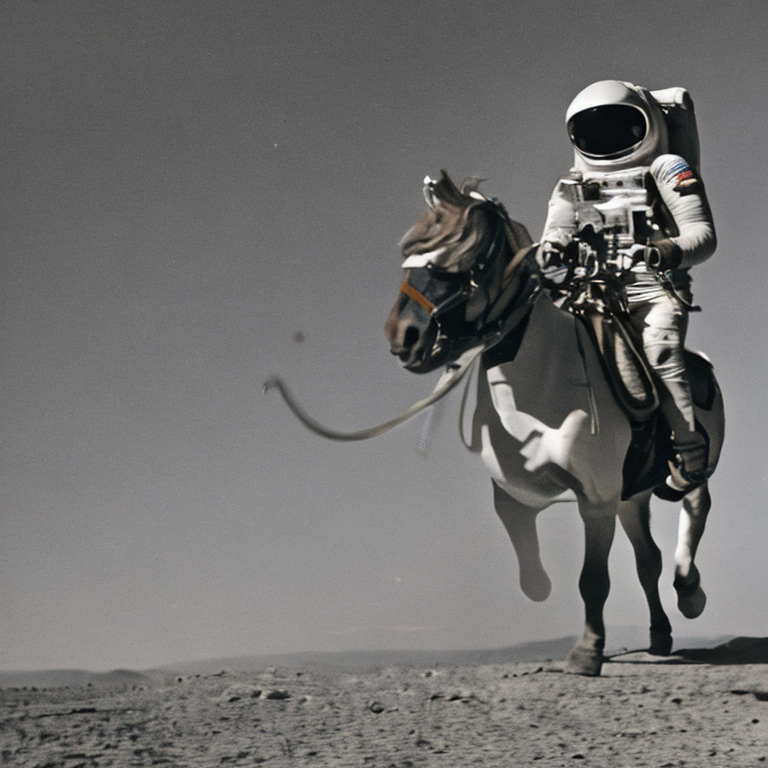

In [13]:
image

In [14]:
# image.save(f"astronaut_rides_horse.png")

Running the above cell multiple times will give you a different image every time. If you want deterministic output you can pass a random seed to the pipeline. Every time you use the same seed you'll have the same image result.

  0%|          | 0/50 [00:00<?, ?it/s]

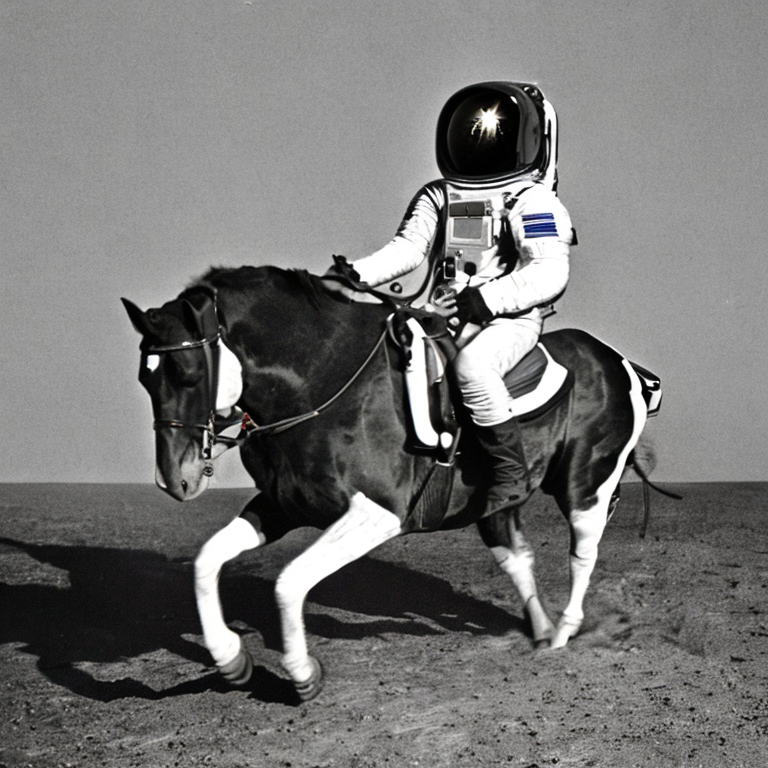

In [15]:
generator = torch.Generator("cuda").manual_seed(1024)

image = pipe(prompt, generator=generator).images[0]

image

You can change the number of inference steps using the `num_inference_steps` argument. In general, results are better the more steps you use. Stable Diffusion, being one of the latest models, works great with a relatively small number of steps, so we recommend to use the default of `50`. If you want faster results you can use a smaller number.

The following cell uses the same seed as before, but with fewer steps. Note how some details, such as the horse's head or the helmet, are less defin realistic and less defined than in the previous image:

  0%|          | 0/15 [00:00<?, ?it/s]

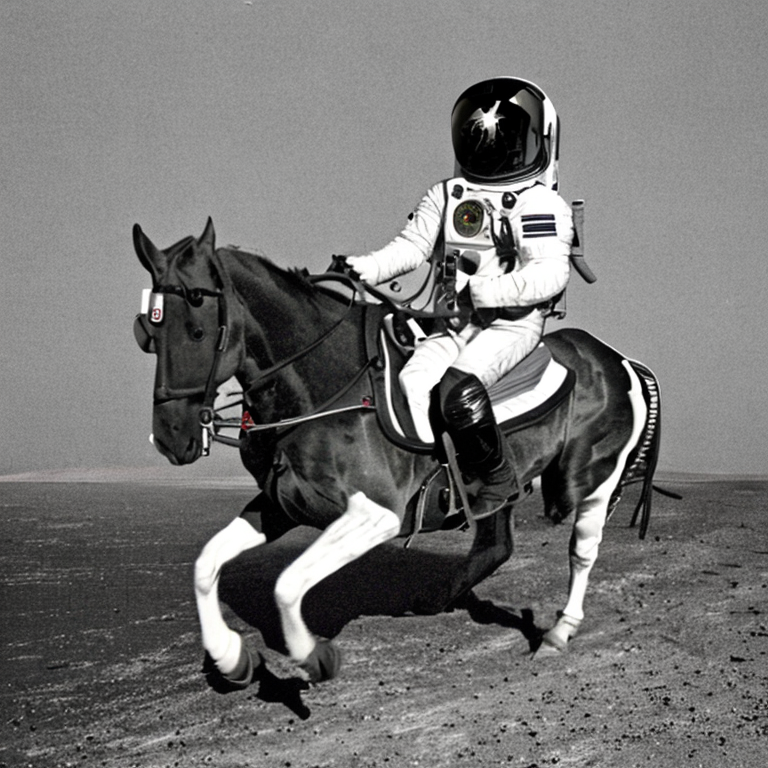

In [16]:
generator = torch.Generator("cuda").manual_seed(1024)

image = pipe(prompt, num_inference_steps=15, generator=generator).images[0]

image

The other parameter in the pipeline call is `guidance_scale`. It is a way to increase the adherence to the conditional signal which in this case is text as well as overall sample quality. In simple terms classifier free guidance forces the generation to better match with the prompt. Numbers like `7` or `8.5` give good results, if you use a very large number the images might look good, but will be less diverse. 

You can learn about the technical details of this parameter in [the last section](https://colab.research.google.com/drive/1ALXuCM5iNnJDNW5vqBm5lCtUQtZJHN2f?authuser=1#scrollTo=UZp-ynZLrS-S) of this notebook.

To generate multiple images for the same prompt, we simply use a list with the same prompt repeated several times. We'll send the list to the pipeline instead of the string we used before.



Let's first write a helper function to display a grid of images. Just run the following cell to create the `image_grid` function, or disclose the code if you are interested in how it's done.

In [17]:
def image_grid(imgs: list[Image.Image], rows: int, cols: int):
    assert len(imgs) == rows * cols

    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

Now, we can generate a grid image once having run the pipeline with a list of 3 prompts.

  0%|          | 0/50 [00:00<?, ?it/s]

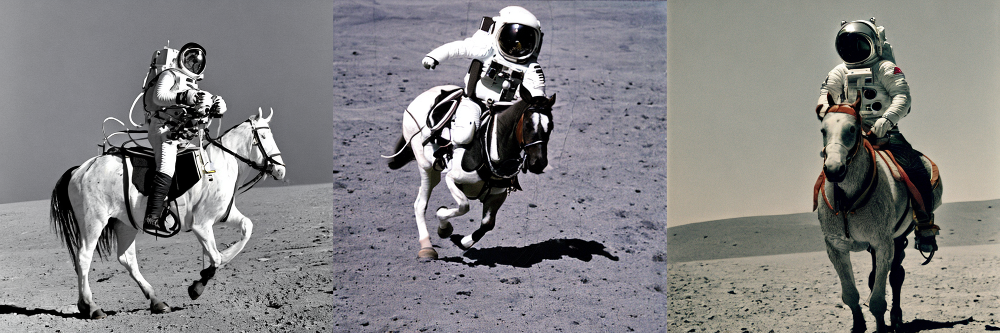

In [18]:
num_images = 3
prompt = ["a photograph of an astronaut riding a horse"] * num_images

images = pipe(prompt).images

grid = image_grid(images, rows=1, cols=3)
grid

And here's how to generate a grid of `n × m` images.

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

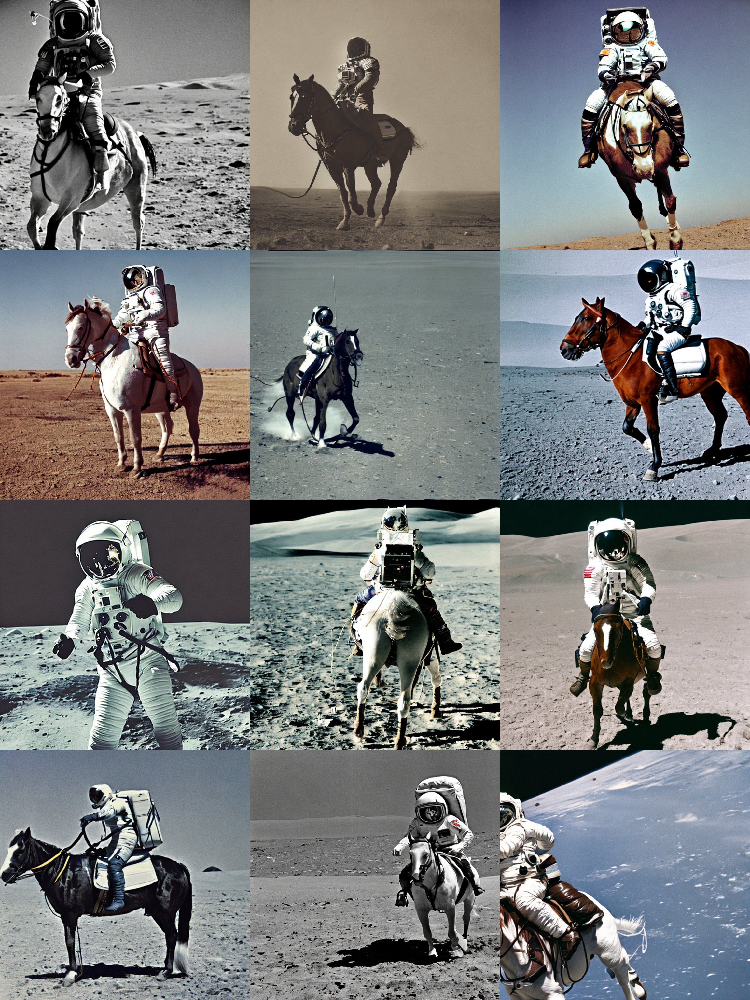

In [19]:
num_cols = 3
num_rows = 4

prompt = ["a photograph of an astronaut riding a horse"] * num_cols

all_images = []
for i in range(num_rows):
    images = pipe(prompt).images
    all_images.extend(images)

grid = image_grid(all_images, rows=num_rows, cols=num_cols)
grid

### Generate non-square images

Stable Diffusion produces images of `512 × 512` pixels by default. But it's very easy to override the default using the `height` and `width` arguments, so you can create rectangular images in portrait or landscape ratios.

These are some recommendations to choose good image sizes:
- Make sure `height` and `width` are both multiples of `8`.
- Going below 512 might result in lower quality images.
- Going over 512 in both directions will repeat image areas (global coherence is lost).
- The best way to create non-square images is to use `512` in one dimension, and a value larger than that in the other one.

  0%|          | 0/50 [00:00<?, ?it/s]

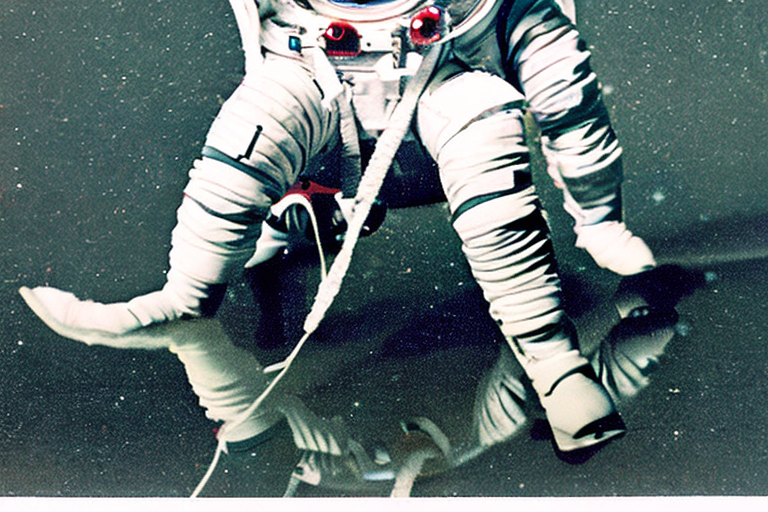

In [20]:
prompt = "a photograph of an astronaut riding a horse"

image = pipe(prompt, height=512, width=768).images[0]
image